In [1]:
#%load_ext autoreload
#%autoreload 2

# Image analysis

## Load images and datasets

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import PIL # used for image openening


In [3]:
from config import res_folder, seeds, methods, method_names_dict
from config import res_folder, seeds, all_locs

from deepal_PV.data_loader import PVDataSet
from deepal_PV.data_loader import PVDataSetAll

In [4]:
all_locs

['CA-F', 'CA-S', 'FR-G', 'FR-I', 'DE-G', 'NY-Q']

In [5]:
### Container for which images the acquisition function selected
a_coreset = np.load(f"{res_folder}/controlled/from_scratch//100_16_42/KCenterGreedy/result.npz")
a_ent = np.load(f"{res_folder}/controlled/from_scratch//100_16_42/EntropySampling/result.npz")
a_rand = np.load(f"{res_folder}/controlled/from_scratch//100_16_42/RandomSampling/result.npz")
a_bald = np.load(f"{res_folder}/controlled/from_scratch//100_16_42/BALDDropout/result.npz")


In [6]:
pv_dataset_all = PVDataSetAll() # note that this does not contain any data only links to png files

CA-F
CA-S
DE-G
FR-G
FR-I
NY-Q/


In [7]:
pv_dataset = PVDataSet() # note that this does not contain any data only links to png files

CA-F
CA-S
DE-G
FR-G
FR-I
NY-Q/


In [8]:
pv_dataset.data_loc_dict.keys()

dict_keys(['CA-F', 'CA-S', 'DE-G', 'FR-G', 'FR-I', 'NY-Q/'])

In [9]:
pv_dataset.data_train_test_dict.keys()

dict_keys(['train', 'test'])

# Dataset statistics (Table 1)

In [10]:
from config import all_locs
from collections import defaultdict

In [11]:
locs = ['CA-F', 'CA-S', 'DE-G', 'FR-G', 'FR-I',  'NY-Q/']


In [12]:
data_loc_dict = defaultdict(dict)


for loc in locs:
    data_loc_dict[loc, "imgs"] = len(pv_dataset_all.data_loc_img[loc]["train"]) #+ len(pv_dataset_all.data_loc_img[loc]["test"])
    data_loc_dict[loc, "blanks"] = len(pv_dataset_all.data_loc_img[loc]["blanks"]) 

In [13]:
for loc in locs:
    a = set(pv_dataset_all.data_loc_img[loc]["train"]) 
    b = set(pv_dataset_all.data_loc_img[loc]["test"])
    c = set(pv_dataset_all.data_loc_img[loc]["blanks"])

    print(loc)
    print(f"{len(a.union(b) - c)} positive images")
    print(f"{len(c)} blankets")
    print(f"{len(c.union(b)-a)} test  blankets")
    print(f"{len(a.union(c))} all images")
    print(f"{len(b)} test images in full")
    print(f"{len(b-c)} test images in positives")
    
    print("\n")


CA-F
4193 positive images
22175 blankets
988 test  blankets
26168 all images
988 test images in full
200 test images in positives


CA-S
1045 positive images
4971 blankets
935 test  blankets
5816 all images
935 test images in full
200 test images in positives


DE-G
1324 positive images
9055 blankets
963 test  blankets
10179 all images
963 test images in full
200 test images in positives


FR-G
13304 positive images
15503 blankets
975 test  blankets
28607 all images
975 test images in full
200 test images in positives


FR-I
7684 positive images
9641 blankets
961 test  blankets
17125 all images
961 test images in full
200 test images in positives


NY-Q/
1008 positive images
5328 blankets
938 test  blankets
6136 all images
938 test images in full
200 test images in positives




In [14]:
img_sizes=dict()
img_n=dict()
for idx, loc in enumerate(locs):
    
    a = pv_dataset.data_loc_dict[loc]
    np.random.shuffle(a)

    no_pxls=0
    no_class=0
    img_n[loc] = len(a)
    for f in a[0:1]:
        f_mask = pv_dataset.data_dict[f]
        mask = PIL.Image.open(f_mask)
        mask = np.array(mask)
        print(f"{loc}: {mask.shape}, {mask.shape}")
        img_sizes[loc] = mask.shape[0] * mask.shape[1]
        

CA-F: (625, 625), (625, 625)
CA-S: (625, 625), (625, 625)
DE-G: (640, 639), (640, 639)
FR-G: (400, 400), (400, 400)
FR-I: (400, 400), (400, 400)
NY-Q/: (625, 625), (625, 625)


In [15]:
### Find ratio of positive pixels
res_no_pxls, res_no_class = [],[]

for idx, loc in enumerate(pv_dataset.data_loc_dict.keys()):
    print(loc)
    a = pv_dataset.data_loc_dict[loc]
    np.random.shuffle(a)
    print(len(a))

    no_pxls=0
    no_class=0

    for f in a:
        f_mask = pv_dataset.data_dict[f]
        mask = PIL.Image.open(f_mask)
        mask = np.array(mask)
        no_pxls = no_pxls + mask.flatten().shape[0]
        no_class = no_class + (mask==255).sum() # (mask==255).sum() is number of positive pixels
    res_no_pxls.append(no_pxls)
    res_no_class.append(no_class)

CA-F
4192
CA-S
1044
DE-G
1325
FR-G
13303
FR-I
7685
NY-Q/
1007


In [16]:
#### Share positive images
vals=[]
for idx, loc in enumerate(pv_dataset.data_loc_dict.keys()):
    val = ((np.array(res_no_class)[idx] / (np.array(res_no_pxls)[idx]))*100)
    vals.append(val)
    print(f"{val:.2f}%")

0.38%
0.36%
0.95%
1.85%
0.61%
1.48%


In [17]:
#### Share positive images
vals=[]
for idx, loc in enumerate(locs):
    val = ((np.array(res_no_class) / np.array(res_no_pxls))*100)[idx]
    vals.append(val)
    print(f"{val:.2f}%")

0.38%
0.36%
0.95%
1.85%
0.61%
1.48%


In [18]:
#### Share positive images

vals=[]
for idx, loc in enumerate(pv_dataset.data_loc_dict.keys()):
    val = ((np.array(res_no_class) / np.array(res_no_pxls))*100)[idx]
    vals.append(val)
    print(f"{val:.2f}%")

0.38%
0.36%
0.95%
1.85%
0.61%
1.48%


In [19]:
#### Share all images

vals=[]
for idx, loc in enumerate(locs):
    val = ((np.array(res_no_class)[idx] / (np.array(res_no_pxls)[idx] + img_sizes[loc]*len(pv_dataset_all.data_loc_img[loc]["blanks"])))*100)
    vals.append(val)
    print(f"{val:.2f}%")

0.06%
0.06%
0.12%
0.86%
0.27%
0.23%


In [20]:
#### Share positive images
vals=[]
for f in range(6):
    val = ((np.array(res_no_class) / np.array(res_no_pxls))*100)[f]
    vals.append(val)
    print(f"{val:.2f}%")

0.38%
0.36%
0.95%
1.85%
0.61%
1.48%


### Image statistics (Used for dataset description)

In [21]:
from scipy.stats import entropy


In [22]:
_bins = 128

CA-F:std_rgb: [44.59205973 34.92987097 29.75108792], mean_rgb: [126.04941205 129.3298318  117.55046712] entropy: 5.984627895383916
CA-S:std_rgb: [46.12663658 36.71053751 38.01418087], mean_rgb: [111.63599435 116.88143954 102.41472384] entropy: 6.1787403042776505
DE-G:std_rgb: [61.70714434 54.74725944 51.2578761 ], mean_rgb: [95.53978657 98.2144935  90.36680171] entropy: 6.0256750812207205
FR-G:std_rgb: [54.89786657 50.86490892 48.94649137], mean_rgb: [90.83347506 91.54578942 79.7199061 ] entropy: 6.195296546011585
FR-I:std_rgb: [49.62177853 43.1333586  43.30068345], mean_rgb: [116.54544631 119.62064898 109.52932135] entropy: 6.280938538214294
NY-Q/:std_rgb: [62.27811844 57.53141674 58.92036195], mean_rgb: [120.03727625 124.89477611 122.8417399 ] entropy: 6.616310008494609


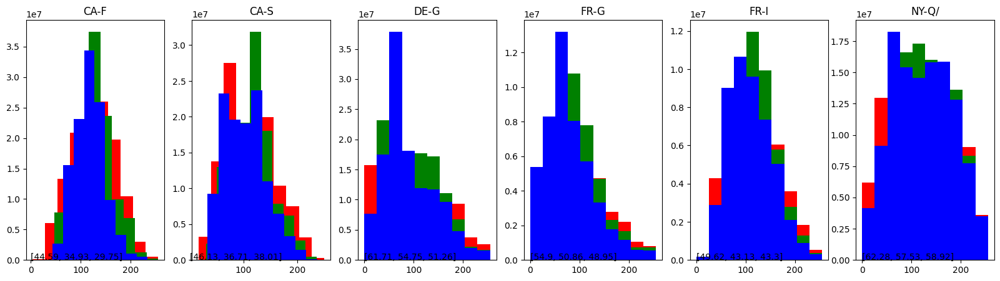

In [23]:
fig, axs = plt.subplots(1,6, figsize=(20,5), sharex=False, sharey=False)
#loc = "DE-G"
std_s=[]
mean_s=[]
img_gs_tot=[]
for idx, loc in enumerate(pv_dataset.data_loc_dict.keys()):
    a = pv_dataset.data_loc_dict[loc][0:300]
    np.random.shuffle(a)
    imgs = []
    
    img_gs = []
    for f in a:
        img = PIL.Image.open(f)
        img_g = np.array(img.convert('L')).flatten()
        img = img.convert("RGB")
        img = np.array(img).transpose(2,0,1).reshape(3,-1)
        imgs.append(img)
        hist, _ = np.histogram(img_g.ravel(), bins=_bins, range=(0, _bins))
        prob_dist = hist / hist.sum()
        image_entropy = entropy(prob_dist, base=2)

        img_gs.append(image_entropy)
    img_gs_tot.append(img_gs)
    img_s = np.hstack(imgs)
    img_gs = np.hstack(img_gs)
    std = np.std(img_s, axis=1)
    mean_ = np.mean(img_s, axis=1)
    mean_s.append(mean_)
    std_s.append(std)
    axs[idx].hist(img_s[0], color="r")
    axs[idx].hist(img_s[1], color="g")
    axs[idx].hist(img_s[2], color="b")

    _bins = 128

    
    axs[idx].set_title(f"{loc}")
    axs[idx].text(0,-1, list(np.round(std,2)))

    print(f"{loc}:std_rgb: {std}, mean_rgb: {mean_} entropy: {np.mean(img_gs)}")
#plt.savefig("loc_comp.png")

(array([ 4159295.,  9124153., 18264503., 15402340., 14544489., 15797317.,
        15842692., 12827382.,  7738500.,  3486829.]),
 array([  0. ,  25.5,  51. ,  76.5, 102. , 127.5, 153. , 178.5, 204. ,
        229.5, 255. ]),
 <BarContainer object of 10 artists>)

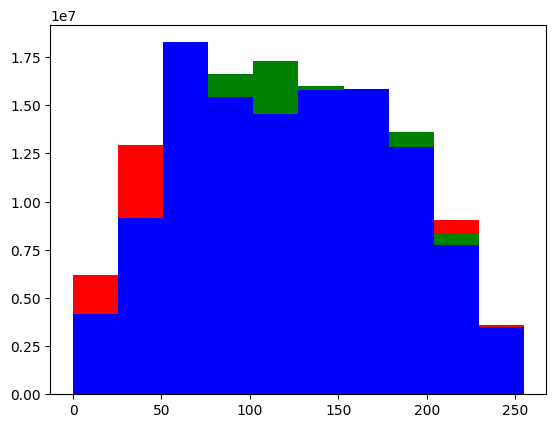

In [24]:
plt.hist(img_s[0], color="r")
plt.hist(img_s[1], color="g")
plt.hist(img_s[2], color="b")

# Which images are selected in DeepAL?

In [25]:
import pandas as pd
import seaborn as sns

In [26]:
a_coreset = np.load(f"{res_folder}/controlled/from_scratch/100_16_42/KCenterGreedy/result.npz")
a_ent = np.load(f"{res_folder}/controlled/from_scratch/100_16_42/EntropySampling/result.npz")
a_rand = np.load(f"{res_folder}/controlled/from_scratch/100_16_42/RandomSampling/result.npz")
a_bald = np.load(f"{res_folder}/controlled/from_scratch/100_16_42/BALDDropout/result.npz")

In [27]:
!ls $res_folder/controlled/from_scratch/100_16_41/

BALDDropout  EntropySampling  KCenterGreedy  RandomSampling


Text(0, 0.5, '# of sampled images')

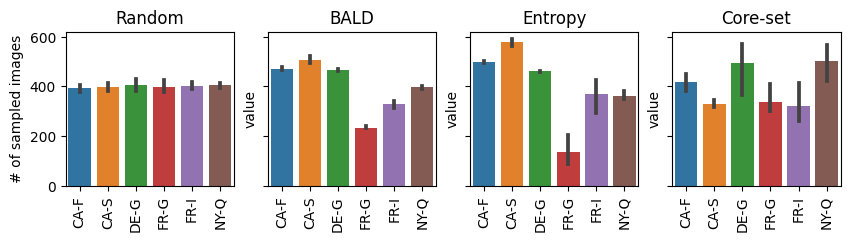

In [28]:
import os
import pandas as pd

fig, axs = plt.subplots(1,4,figsize=(10,2), sharey=True)

for m_idx, m in enumerate(methods):
    a_s=[]
    for s_idx, s in enumerate(seeds):
        ress=[]
        a_f = np.load(f"{res_folder}/controlled/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a.sum(axis=1))
    
    df_a_s = pd.DataFrame(a_s).T
    g = sns.barplot(df_a_s.T.melt(), ax=axs[m_idx],  x="variable", y="value")
    axs[m_idx].tick_params(axis='x', labelrotation=90)
    #g.set_xticks(rotation=90)

    axs[m_idx].set_title(method_names_dict[m])
    axs[m_idx].set_xlabel("")
    #axs[m_idx].set_xticklabels(xticklabels, rotation = 45, ha="right")
    

axs[0].set_ylabel("# of sampled images")

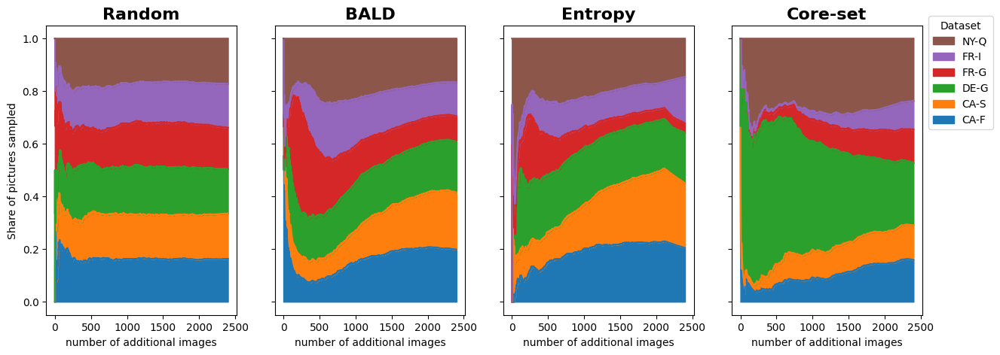

In [29]:
res_dict={}
fig, axs = plt.subplots(1,4,figsize=(15,5), sharey=True)
for m_idx, m in enumerate(methods):
    a_s=[]
    for s_idx, s in enumerate(seeds[1:2]):
        ress=[]
        a_f = np.load(f"{res_folder}/controlled/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.4, 1.05), title="Dataset")
axs[0].set_ylabel("Share of pictures sampled")
plt.savefig("paper_plots/controlled_accu_img.pdf", bbox_inches="tight")


### Same images sampled

In [30]:
import os
import pandas as pd

res_d={}
for m_idx, m in enumerate(methods):
    a_s=[]
    vals=[]
    for s_idx, s in enumerate(seeds):
        ress=[]
        a_f = np.load(f"{res_folder}/controlled/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                #loc = os.path.dirname(val).split("/")[-3]
                res.append(val)
            ress.append(res)
        val = np.array(ress).flatten()
        vals.append(val)
    res_d[m] = np.array(vals)
    

In [31]:
from itertools import combinations

l_methods = list(combinations(methods,2))


In [32]:
from config import all_locs

In [33]:
all_locs

['CA-F', 'CA-S', 'FR-G', 'FR-I', 'DE-G', 'NY-Q']

In [34]:
l_methods

[('RandomSampling', 'BALDDropout'),
 ('RandomSampling', 'EntropySampling'),
 ('RandomSampling', 'KCenterGreedy'),
 ('BALDDropout', 'EntropySampling'),
 ('BALDDropout', 'KCenterGreedy'),
 ('EntropySampling', 'KCenterGreedy')]

In [35]:
res={}
res_m={}
for l in l_methods:
    for idx in range(3):
        set1 = set(res_d[l[0]][idx][0:1500])
        set2 = set(res_d[l[1]][idx][0:1500])

        set_inters = set1.intersection(set2)
        if idx==0:
            res[l] = [len(set_inters)]
        else:
            res[l].append(len(set_inters))       
    #res_m[l] = np.mean(res[l])

In [36]:
n_img = len(res_d[l[0]][idx])

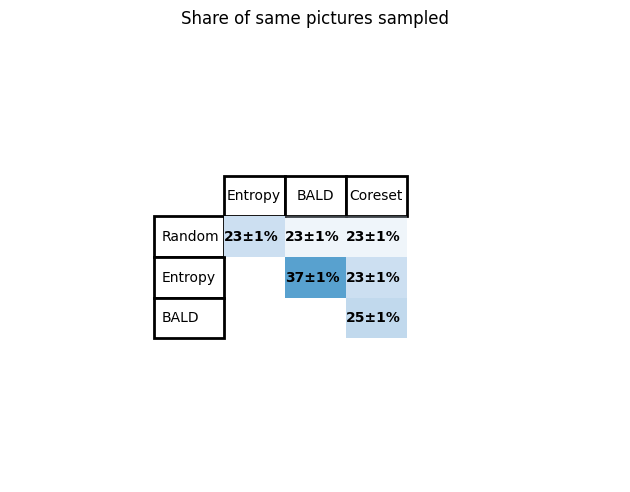

In [37]:
import numpy as np
from matplotlib import pyplot as plt

res_d = dict() 
res_str = dict()
for l in l_methods:
    #print(l)
    #print(f"{np.mean(res[l])/800:.2f}")
    #print(f"{np.std(np.array(res[l])/800):.2f}")
    v0 = np.array(res[l])
    v = np.mean(v0/n_img)*100
    v_ = np.std(v0/n_img)*100
    res_d[l] = int(v)
    res_str[l] = f"{v:.0f}±{v_:.0f}%"
    
    
rows = ['%d nodes' % x for x in (10, 30, 50, 75, 100)]
columns = ['Entropy', 'BALD', 'Coreset']
rows = ['Random', 'Entropy', 'BALD']
conf_data = np.array([[res_d[("RandomSampling","EntropySampling")], res_d[("RandomSampling","BALDDropout")], res_d[("RandomSampling","KCenterGreedy")]],
                      [np.nan, res_d[("BALDDropout","EntropySampling")], res_d[("RandomSampling","KCenterGreedy")]],
                      [np.nan, np.nan, res_d[("BALDDropout","KCenterGreedy")]],
                      #[np.nan, np.nan, np.nan, np.nan]
                     ])
#conf_data = conf_data.astype(int)

conf_data_str = np.array([[res_str[("RandomSampling","EntropySampling")], res_str[("RandomSampling","BALDDropout")], res_str[("RandomSampling","KCenterGreedy")]],
                      [np.nan, res_str[("BALDDropout","EntropySampling")], res_str[("RandomSampling","KCenterGreedy")]],
                      [np.nan, np.nan, res_str[("BALDDropout","KCenterGreedy")]],
                      #[np.nan, np.nan, np.nan, np.nan]
                         ])

conf_data0 = conf_data_str.tolist() 

conf_data0[1][0] = None
conf_data0[2][0] = None
conf_data0[2][1] = None

import numpy as np
from matplotlib import pyplot as plt
import matplotlib.colors as mcolors

fig, ax = plt.subplots()


fig.patch.set_visible(False)
ax.axis('off')
ax.axis('tight')

cmap = plt.cm.Blues
norm = mcolors.Normalize(vmin=np.nanmin(conf_data)-10, vmax=np.nanmax(conf_data)+20)

color_matrix = np.empty(conf_data.shape, dtype=object)
for i in range(conf_data.shape[0]):
    for j in range(conf_data.shape[1]):
        if np.isnan(conf_data[i, j]):
            color_matrix[i, j] = cmap(np.nan)
        else:
            color_matrix[i, j] = cmap(norm(conf_data[i, j]))

table = ax.table(cellText=conf_data0,
                 rowLabels=rows,
                 colLabels=columns,
                 cellColours=color_matrix,
                 loc='center',
                 colWidths=[0.05 for x in columns])

for cell in table._cells:
    if cell in ((1,1),(1,2)):
        table._cells[cell].set_alpha(.3)

table.auto_set_font_size(False)
table.set_fontsize(10)
#table.auto_set_column_width(col=list(range(len(df.columns))))
for asd, cell in table.get_celld().items():
    if (asd[0]>0) and (asd[1]>=0):
        cell.set_edgecolor(None)  # Removing the cell borders

from matplotlib.font_manager import FontProperties

for asd, cell in table.get_celld().items():
    if (asd[0]>0) and (asd[1]>=0):
        cell.get_text().set_color("black")
        cell.set_text_props(fontproperties=FontProperties(weight='bold'))

    else:
        #cell.set_edgecolor("blue")
        cell.set_linewidth(2)
        
table.scale(2, 2) # make table a little bit larger
fig.tight_layout()
plt.title("Share of same pictures sampled")
plt.show()

# Imbalanced data


Text(0, 0.5, 'Share of pictures sampled')

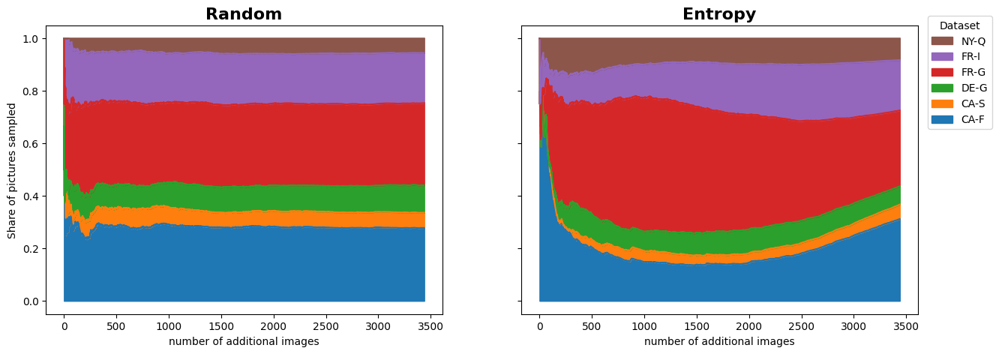

In [38]:
methods_s = ['RandomSampling', 'EntropySampling']
res_dict={}
fig, axs = plt.subplots(1,2,figsize=(15,5), sharey=True)
for m_idx, m in enumerate(methods_s):
    a_s=[]
    for s_idx, s in enumerate(seeds[2:3]):
        ress=[]
        a_f = np.load(f"{res_folder}/all/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.2, 1.05), title="Dataset")
axs[0].set_ylabel("Share of pictures sampled") 
#plt.savefig("paper_plots/all_accu_img.pdf", bbox_inches="tight")

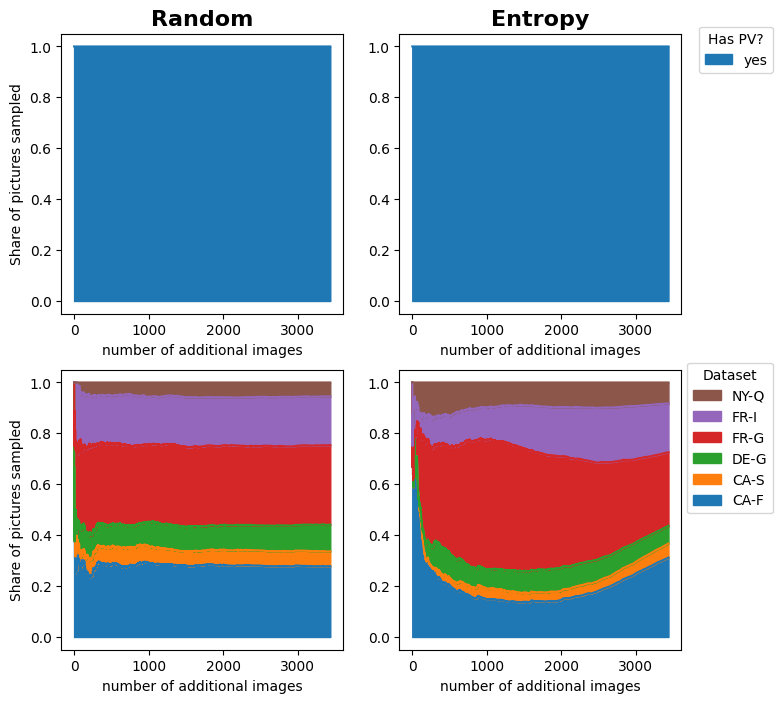

In [39]:
res_dict={}
fig, axs_ = plt.subplots(2,2,figsize=(8,8))
axs = axs_[0,:]
for m_idx, m in enumerate(methods_s):
    a_s=[]
    for s_idx, s in enumerate(seeds[2:3]):
        ress=[]
        a_f = np.load(f"{res_folder}/all/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                if loc == "NY-Q":
                    loc = "NY-Q/"
                t_bol = val in pv_dataset_all.data_loc_img[loc]["blanks"]
                if t_bol == True:
                    t_bol_val = "no"
                elif t_bol == False:
                    t_bol_val = "yes"
                res.append(t_bol_val)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.35, 1.05), title="Has PV?")
axs[0].set_ylabel("Share of pictures sampled") 


res_dict={}
axs = axs_[1,:]

for m_idx, m in enumerate(methods_s):
    a_s=[]
    for s_idx, s in enumerate(seeds[2:3]):
        ress=[]
        a_f = np.load(f"{res_folder}/all/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    #axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.35, 1.05), title="Dataset")
axs[0].set_ylabel("Share of pictures sampled") 
plt.savefig("paper_plots/all_accu_img_res.pdf", bbox_inches="tight")

In [40]:
(a.cumsum(axis=1) / (a.columns+1)).T

,CA-F,CA-S,DE-G,FR-G,FR-I,NY-Q
0,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.750000,0.000000,0.000000,0.000000,0.000000,0.250000
4,0.800000,0.000000,0.000000,0.000000,0.000000,0.200000
...,...,...,...,...,...,...
3435,0.311700,0.055006,0.069849,0.288999,0.192084,0.082363
3436,0.311900,0.054990,0.069828,0.288915,0.192028,0.082339
3437,0.311809,0.055265,0.069808,0.288831,0.191972,0.082315
3438,0.312009,0.055249,0.069788,0.288747,0.191916,0.082291


In [41]:
def merge_specific_rows(df, row_pairs):
    for i, j in row_pairs:
        # Merge rows - here we use summing as an example
        merged_row = df.loc[i] + df.loc[j]
        # Replace the row at index i with the merged row
        df.loc[i] = merged_row
        # Drop the row at index j
        df.drop(j, inplace=True)

    # Reset the DataFrame index
    df.reset_index(drop=True, inplace=True)
    return df
row_pairs = [("CA-F","CA-S"), ("DE-G", "NY-Q"), ("FR-G", "FR-I")]


Text(0, 0.5, 'Share of pictures sampled')

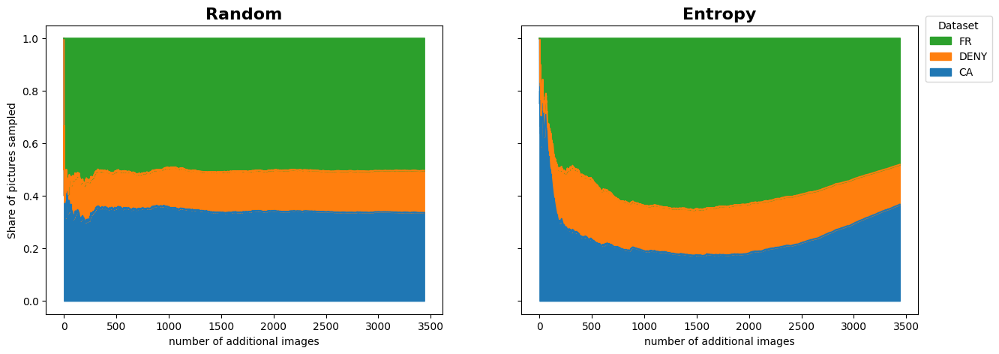

In [42]:
res_dict={}
fig, axs = plt.subplots(1,2,figsize=(15,5), sharey=True)
for m_idx, m in enumerate(methods_s):
    a_s=[]
    for s_idx, s in enumerate(seeds[2:3]):
        ress=[]
        a_f = np.load(f"{res_folder}/all/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        df_merged = merge_specific_rows(a, row_pairs)
        df_merged.index = ["CA","DENY","FR"]
        a_s.append(df_merged)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.2, 1.05), title="Dataset")
axs[0].set_ylabel("Share of pictures sampled") 
#plt.savefig("paper_plots/all_accu_img.pdf", bbox_inches="tight")

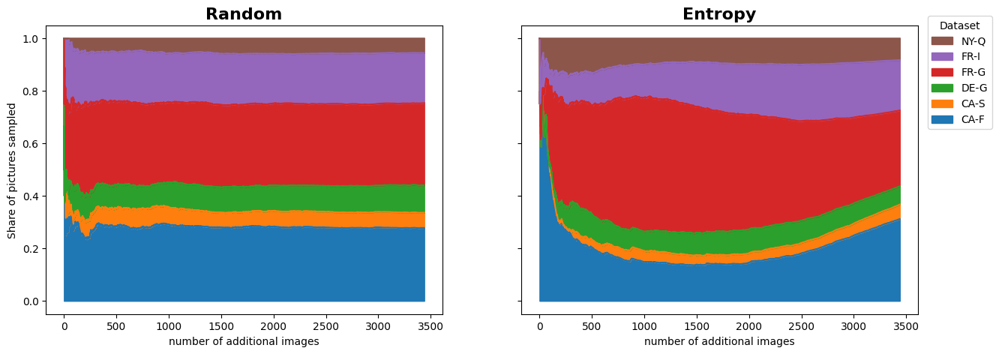

In [43]:
res_dict={}
fig, axs = plt.subplots(1,2,figsize=(15,5), sharey=True)
for m_idx, m in enumerate(methods_s):
    a_s=[]
    for s_idx, s in enumerate(seeds[2:3]):
        ress=[]
        a_f = np.load(f"{res_folder}/all/from_scratch/100_16_{s}/{m}/result.npz")
        for b in a_f["selected_img_batches"]: # a_coreset #a_ent a_rand
            res=[]
            for val in b:
                loc = os.path.dirname(val).split("/")[-3]
                res.append(loc)
            ress.append(res)
        val = np.array(ress).flatten()
        df = pd.Series(val)
        a = pd.get_dummies(df).T
        a_s.append(a)
    #res_dict[m] = a_s
    p = (a.cumsum(axis=1) / (a.columns+1)).T.plot.area(ax=axs[m_idx], legend=False)
    axs[m_idx].set_title(method_names_dict[m], fontsize=16, fontweight="bold")
    axs[m_idx].set_xlabel("number of additional images")
    
handles, labels = axs[m_idx].get_legend_handles_labels()
axs[m_idx].legend(reversed(handles), reversed(labels),  loc='upper right', bbox_to_anchor=(1.2, 1.05), title="Dataset")
axs[0].set_ylabel("Share of pictures sampled") 
plt.savefig("paper_plots/all_accu_img.pdf", bbox_inches="tight")

## Sampled images illustrations

In [44]:
img_size = (320,320)

In [45]:
a_ent = np.load(f"{res_folder}/controlled/from_scratch/100_16_41/EntropySampling/result.npz")
a_ent_all = np.load(f"{res_folder}/all/from_scratch/100_16_41/EntropySampling/result.npz")


ok


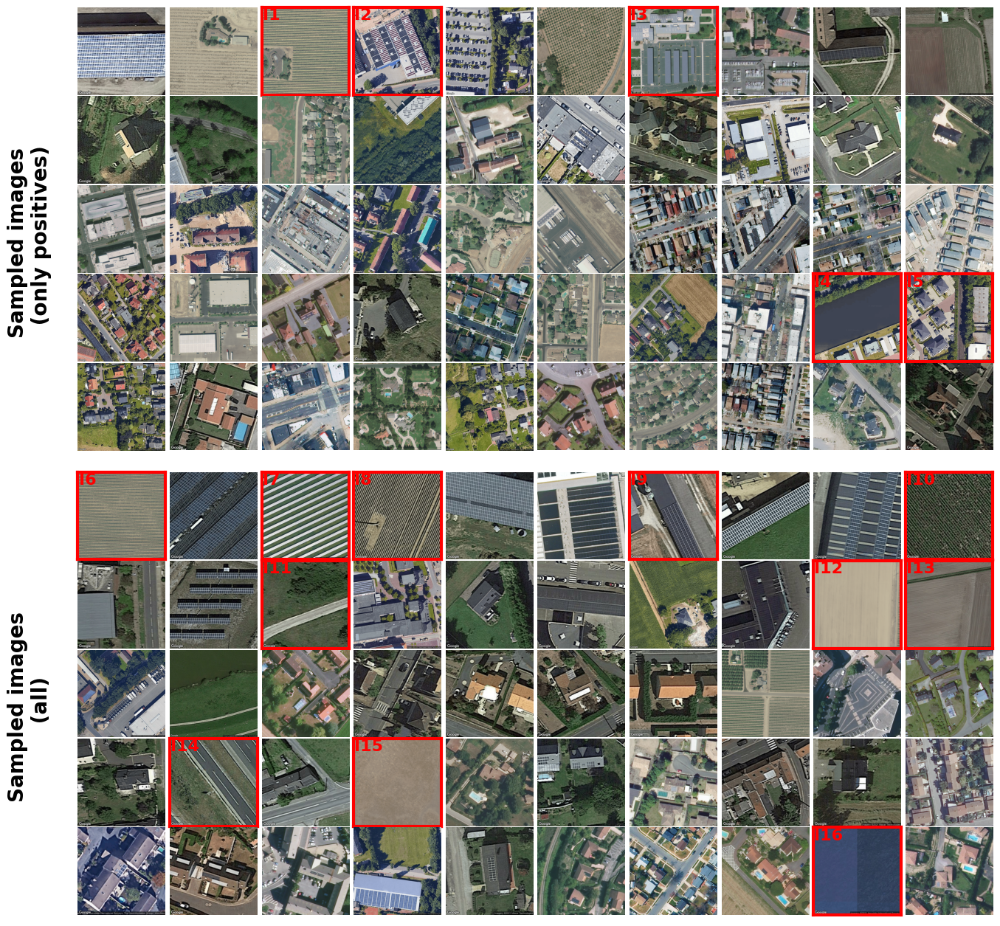

In [46]:
img_batches = a_ent["selected_img_batches"]
fig,axs= plt.subplots(11,10, figsize=(16,16), gridspec_kw={"width_ratios":np.repeat(1.1, 10), 
                                                           "height_ratios":np.repeat(1.1,5).tolist() + [.25] +  np.repeat(1.1,5).tolist()})
r_idx = 0
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        img = mpimg.imread(img_f)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0

for i_col in range(10):
    axs[r_idx,i_col].set_visible(False)


print("ok")

    
r_idx = r_idx+1
img_batches = a_ent_all["selected_img_batches"]
idx = 0
for img_batch in img_batches[0:150:3]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        with PIL.Image.open(img_f) as img:
            img = img.convert('RGB').resize(img_size)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0
plt.subplots_adjust(wspace=0.05, hspace=0)

def _highlight_img(idx=(0,0), title="a"):
    axs[idx].set_facecolor("black")
    axs[idx].text(.01, .99, title, ha='left', va='top', fontdict={"size":16, "weight":"bold", "color":"red"}, transform=axs[idx].transAxes)
    axs[idx].patch.set_edgecolor("black")
    axs[idx].axis('on')
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    for spine in axs[idx].spines.values():
        spine.set_edgecolor('red')
        spine.set_linewidth(3)

axs[1,0].text(-.55, .5, "Sampled images \n (only positives)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[1,0].transAxes)
axs[7,0].text(-.55, .5, "Sampled images \n (all)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[7,0].transAxes)

int_imgs = [(0,2),(0,3),(0,6), (3,8), (3,9),
            (6,0),(6,2), (6,3),  (6,6),(6,9),(7,2), (7,8),(7,9),(9,1),(9,3),(10,8)]

for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"I{idx+1}")
#plt.title("ideal")
#plt.savefig("paper_plots/ent_highest_uncert.pdf", bbox_inches="tight")



ok


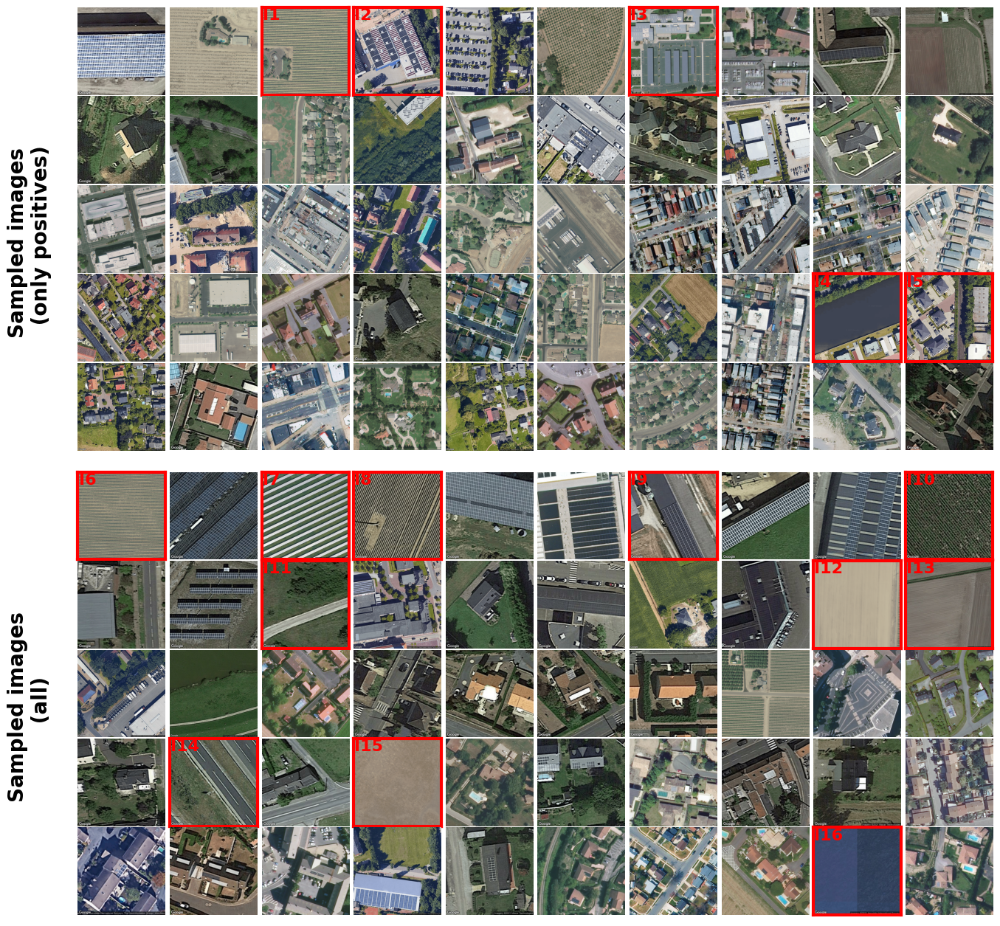

In [47]:
img_batches = a_ent["selected_img_batches"]
fig,axs= plt.subplots(11,10, figsize=(16,16), gridspec_kw={"width_ratios":np.repeat(1.1, 10), 
                                                           "height_ratios":np.repeat(1.1,5).tolist() + [.25] +  np.repeat(1.1,5).tolist()})
r_idx = 0
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        img = mpimg.imread(img_f)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0

for i_col in range(10):
    axs[r_idx,i_col].set_visible(False)


print("ok")

    
r_idx = r_idx+1
img_batches = a_ent_all["selected_img_batches"]
idx = 0
for img_batch in img_batches[0:150:3]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        with PIL.Image.open(img_f) as img:
            img = img.convert('RGB').resize(img_size)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0
plt.subplots_adjust(wspace=0.05, hspace=0)

def _highlight_img(idx=(0,0), title="a"):
    axs[idx].set_facecolor("black")
    axs[idx].text(.01, .99, title, ha='left', va='top', fontdict={"size":16, "weight":"bold", "color":"red"}, transform=axs[idx].transAxes)
    axs[idx].patch.set_edgecolor("black")
    axs[idx].axis('on')
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    for spine in axs[idx].spines.values():
        spine.set_edgecolor('red')
        spine.set_linewidth(3)

axs[1,0].text(-.55, .5, "Sampled images \n (only positives)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[1,0].transAxes)
axs[7,0].text(-.55, .5, "Sampled images \n (all)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[7,0].transAxes)

int_imgs = [(0,2),(0,3),(0,6), (3,8), (3,9),
            (6,0),(6,2), (6,3),  (6,6),(6,9),(7,2), (7,8),(7,9),(9,1),(9,3),(10,8)]

for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"I{idx+1}")
#plt.title("ideal")
#plt.savefig("paper_plots/ent_highest_uncert.pdf", bbox_inches="tight")



0
1
2
3
4
0
1
2
3
4
5
6
7
8
9


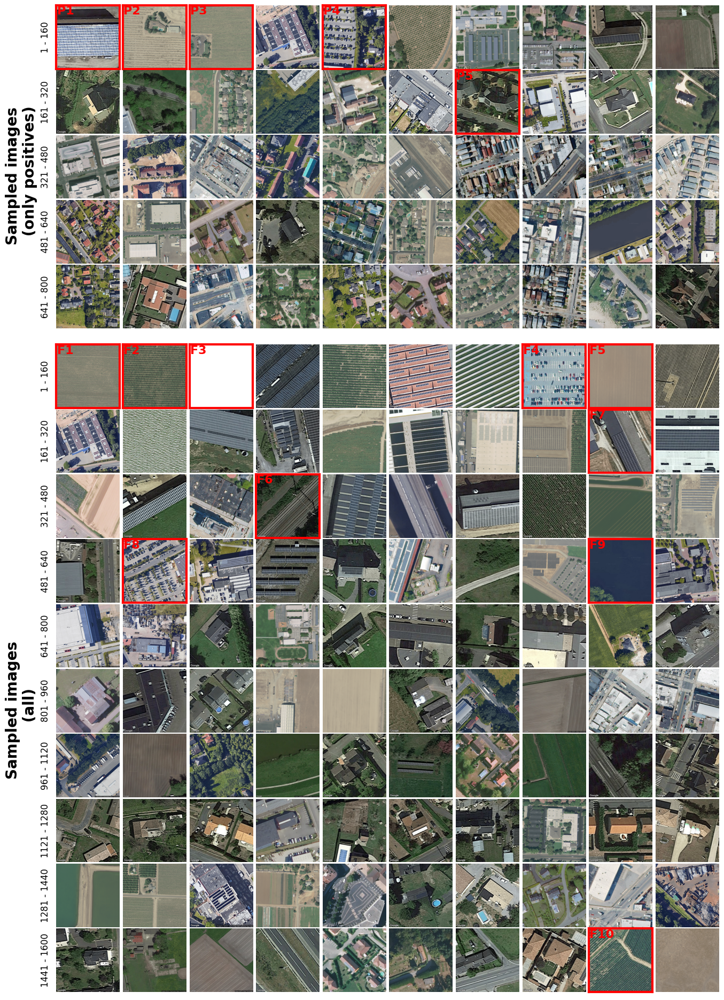

In [48]:
img_batches = a_ent["selected_img_batches"]
fig,axs= plt.subplots(16,10, figsize=(16,24), gridspec_kw={"width_ratios":np.repeat(1.1, 10), 
                                                           "height_ratios":np.repeat(1.1,5).tolist() + [.25] +  np.repeat(1.1,10).tolist()})
r_idx = 0
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        img = mpimg.imread(img_f)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0

for i_col in range(10):
    axs[r_idx,i_col].set_visible(False)


r_idx = r_idx+1
img_batches = a_ent_all["selected_img_batches"]
idx = 0
for img_batch in img_batches[0:100]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        with PIL.Image.open(img_f) as img:
            img = img.convert('RGB').resize(img_size)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0
plt.subplots_adjust(wspace=0.05, hspace=0)

def _highlight_img(idx=(0,0), title="a"):
    axs[idx].set_facecolor("black")
    axs[idx].text(.01, .99, title, ha='left', va='top', fontdict={"size":16, "weight":"bold", "color":"red"}, transform=axs[idx].transAxes)
    axs[idx].patch.set_edgecolor("black")
    axs[idx].axis('on')
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    for spine in axs[idx].spines.values():
        spine.set_edgecolor('red')
        spine.set_linewidth(3)

axs[1,0].text(-.55, .5, "Sampled images \n (only positives)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[1,0].transAxes)
axs[10,0].text(-.55, .5, "Sampled images \n (all)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[10,0].transAxes)

int_imgs = [(0,0),(0,1),(0,2),(0,4), (1,6)]
for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"P{idx+1}")
    
int_imgs = [(6,0),(6,1), (6,2),(6,7),(6,8),(8,3), (7,8),(9,1),(9,8),(15,8)]
for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"F{idx+1}")

for i in range(5):
    print(i)
    #axs[i,0].set_title(i, pad=-300)
    axs[i, 0].text(x=-0.1, y=0.5, s=f"{i*16*10+1} - {(i+1)*16*10}", transform=axs[i, 0].transAxes, 
                   ha='right', va='center', rotation=90, fontsize='large')

    
for i in range(10):
    print(i)
    ax = axs[i+6, 0]
    #axs[i,0].set_title(i, pad=-300)
    ax.text(x=-0.1, y=0.5, s=f"{i*16*10+1} - {(i+1)*16*10}", transform=ax.transAxes, 
                   ha='right', va='center', rotation=90, fontsize='large')
#plt.title("ideal")
plt.savefig("paper_plots/ent_highest_uncert_update.pdf", bbox_inches="tight")

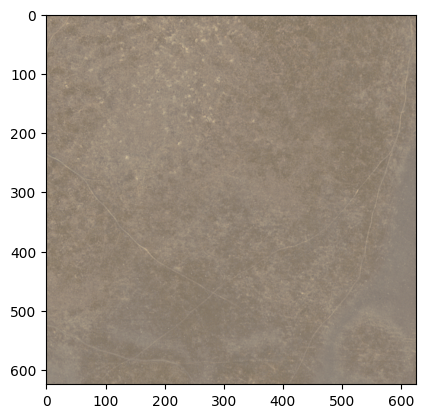

In [49]:
img = mpimg.imread(img_f)
#imgplot = plt.imshow(img)
plt.imshow(img)


ok


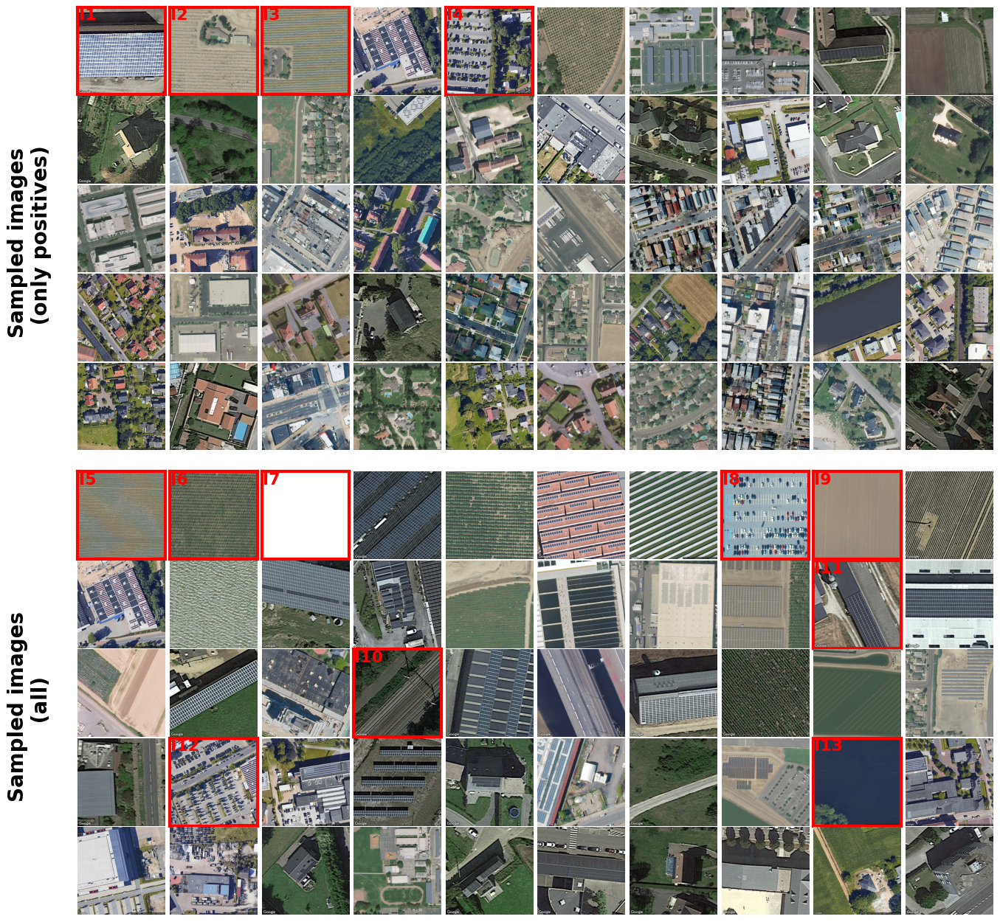

In [50]:
img_batches = a_ent["selected_img_batches"]
fig,axs= plt.subplots(11,10, figsize=(16,16), gridspec_kw={"width_ratios":np.repeat(1.1, 10), 
                                                           "height_ratios":np.repeat(1.1,5).tolist() + [.25] +  np.repeat(1.1,5).tolist()})
r_idx = 0
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        img = mpimg.imread(img_f)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0

for i_col in range(10):
    axs[r_idx,i_col].set_visible(False)


print("ok")

    
r_idx = r_idx+1
img_batches = a_ent_all["selected_img_batches"]
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        with PIL.Image.open(img_f) as img:
            img = img.convert('RGB').resize(img_size)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0
plt.subplots_adjust(wspace=0.05, hspace=0)

def _highlight_img(idx=(0,0), title="a"):
    axs[idx].set_facecolor("black")
    axs[idx].text(.01, .99, title, ha='left', va='top', fontdict={"size":16, "weight":"bold", "color":"red"}, transform=axs[idx].transAxes)
    axs[idx].patch.set_edgecolor("black")
    axs[idx].axis('on')
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    for spine in axs[idx].spines.values():
        spine.set_edgecolor('red')
        spine.set_linewidth(3)

axs[1,0].text(-.55, .5, "Sampled images \n (only positives)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[1,0].transAxes)
axs[7,0].text(-.55, .5, "Sampled images \n (all)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[7,0].transAxes)

int_imgs = [(0,0),(0,1),(0,2),(0,4), 
            (6,0),(6,1), (6,2),(6,7),(6,8),(8,3), (7,8),(9,1),(9,8),]

for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"I{idx+1}")
#plt.title("ideal")
plt.savefig("paper_plots/ent_highest_uncert.pdf", bbox_inches="tight")



ok


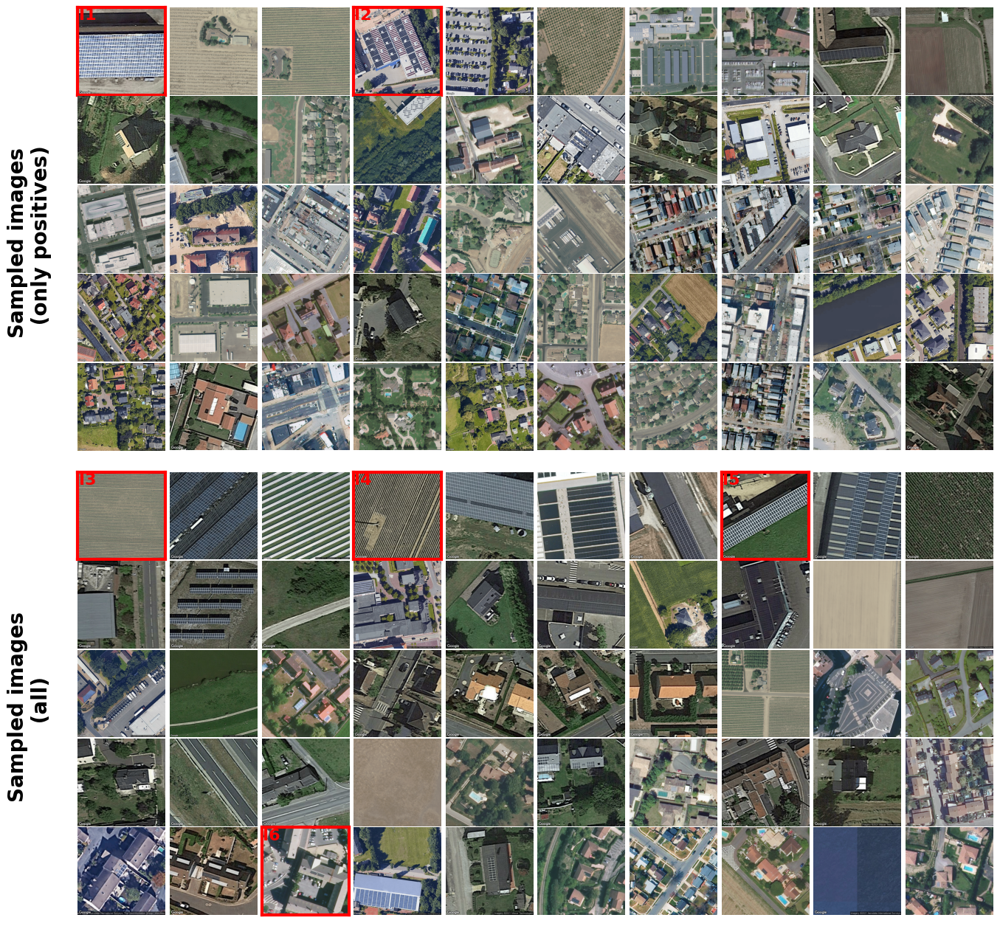

In [51]:
img_batches = a_ent["selected_img_batches"]
fig,axs= plt.subplots(11,10, figsize=(16,16), gridspec_kw={"width_ratios":np.repeat(1.1, 10), 
                                                           "height_ratios":np.repeat(1.1,5).tolist() + [.25] +  np.repeat(1.1,5).tolist()})
r_idx = 0
idx = 0
for img_batch in img_batches[0:50]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        img = mpimg.imread(img_f)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0

for i_col in range(10):
    axs[r_idx,i_col].set_visible(False)


print("ok")

    
r_idx = r_idx+1
img_batches = a_ent_all["selected_img_batches"]
idx = 0
for img_batch in img_batches[0:150:3]:
    for img_f in (img_batch[0:1]):
        #print(img_f)
        with PIL.Image.open(img_f) as img:
            img = img.convert('RGB').resize(img_size)
        #imgplot = plt.imshow(img)
        axs[r_idx,idx].imshow(img)
        axs[r_idx,idx].axis('off')
        idx=idx+1
        if idx == 10:
            r_idx = r_idx+1
            idx = 0
plt.subplots_adjust(wspace=0.05, hspace=0)

def _highlight_img(idx=(0,0), title="a"):
    axs[idx].set_facecolor("black")
    axs[idx].text(.01, .99, title, ha='left', va='top', fontdict={"size":16, "weight":"bold", "color":"red"}, transform=axs[idx].transAxes)
    axs[idx].patch.set_edgecolor("black")
    axs[idx].axis('on')
    axs[idx].set_xticks([])
    axs[idx].set_yticks([])
    for spine in axs[idx].spines.values():
        spine.set_edgecolor('red')
        spine.set_linewidth(3)

axs[1,0].text(-.55, .5, "Sampled images \n (only positives)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[1,0].transAxes)
axs[7,0].text(-.55, .5, "Sampled images \n (all)", rotation=90, ha='center', va='top', fontdict={"size":20, "weight":"bold", "color":"black"}, transform=axs[7,0].transAxes)

int_imgs = [(0,2), (0,4), (1,2), (3,6), (6,0), (6,1), (6,3), (10,2)]
int_imgs = [(0,0), (0,3),(6,0), (6,3), (6,7), (10,2)]

for idx, img in enumerate(int_imgs):
    _highlight_img(img, f"I{idx+1}")
#plt.title("ideal")
plt.savefig("paper_plots/ent_highest_uncert.pdf", bbox_inches="tight")



In [52]:
## show it for the controlled case
a_coreset = np.load(f"{res_folder}/controlled/from_scratch/100_16_43/KCenterGreedy/result.npz") 
a_ent = np.load(f"{res_folder}/controlled/from_scratch/100_16_43/EntropySampling/result.npz")
a_rand = np.load(f"{res_folder}/controlled/from_scratch/100_16_43/RandomSampling/result.npz")
a_bald = np.load(f"{res_folder}/controlled/from_scratch/100_16_43/BALDDropout/result.npz")

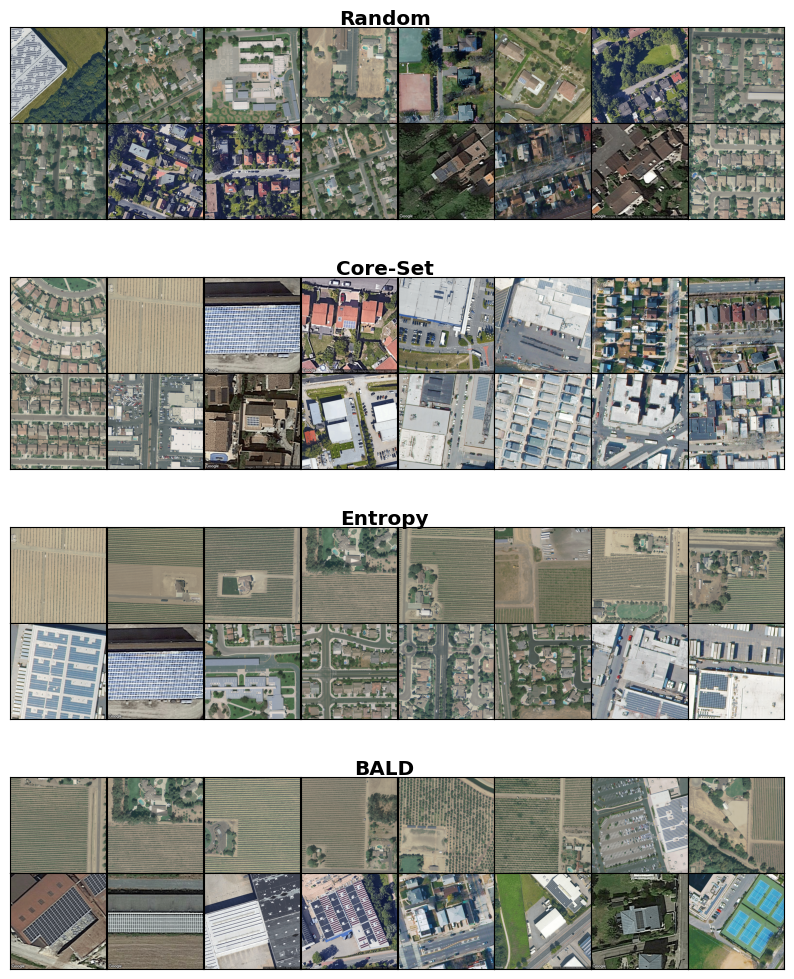

In [53]:
names = ["Random",  "Core-Set", "Entropy", "BALD"]

n_b = 2
n_img = 16

fig = plt.figure(figsize=(10,10)) #,constrained_layout=True

subfigs = fig.subfigures(4,1, wspace=0.07)

for a_i,a in enumerate([a_rand, a_coreset, a_ent, a_bald]):

    axs = subfigs[a_i].subplots(n_b, 8, sharex=True)

    img_batches = a["selected_img_batches"]
    #for b_i, img_batch in enumerate(img_batches[(50-n_b):50]):
    for idx, img_batch in enumerate(img_batches[0:2]):

        for b_i, img_f in enumerate(img_batch[range(n_img)][::2]):

            with PIL.Image.open(img_f) as img:
                img = img.convert('RGB').resize(img_size)
                #img = transform.to_tensor(img)

            #print(img.shape)
            #print(img[0,:399,:].shape)
            axs[idx, b_i].imshow(img, rasterized=True)
            
            axs[idx, b_i].xaxis.set_ticklabels([])
            axs[idx, b_i].yaxis.set_ticklabels([])
            axs[idx, b_i].tick_params(axis=u'both', which=u'both',length=0)

            #if idx == 0 :
            #    axs[idx, b_i].set_ylabel(f"batch {b_i+1}", weight="bold")
                
for i in range(4):
    subfigs.flatten()[i].patch.set_linewidth(.25)
    #subfigs.flatten()[i].set_edgecolor('0.5')
    subfigs.flatten()[i].patch.set_linestyle('--')
    #subfigs.flatten()[i].patch.set_facecolor('0.85')
    
    subfigs[i].subplots_adjust(wspace=.05, hspace=.05)
    subfigs[i].suptitle(names[i], fontsize='x-large', weight="bold", y=.95)
#plt.tight_layout()
plt.subplots_adjust(wspace=0, hspace=0)

plt.savefig("paper_plots/img_com2_h.pdf", bbox_inches="tight")